# Metric comparison with expert asessment

In order to validate metric $\mu$ we gathered some seismograms and their LIFTs and denoised them using 3 different ML models. 

We proposed an expert to rate ML models outputs from worst to best and copared their raiting with values obtained by calculating $\mu$ relative to LIFTs. 

Metric $\mu$ compuation procedure is described in [Metric for evaluating difference between seismograms](./0_metrics_study_intro.ipynb)

We had 2 datasets in this experiment. Here are the results for the first dataset. Results for the second one are in [Metric comparison with expert asessment. Dataset 2](./3_metric_comparison_with_human_ranks_ds2.ipynb)

## Dataset 1

In [1]:
import sys
sys.path.append('..')

import pandas as pd

from functools import reduce

from seismicpro.batchflow import Dataset
from seismicpro.src import SeismicBatch, FieldIndex

from utils import get_cv, draw_modifications_dist, validate_all, get_modifications_list

## Loading data

In [2]:
base_path = '/data/Metrix_QC/' 
      
paths = {
    'lift': '2_QC_Metrix-4.sgy', 
    'raw': '2_QC_Metrix_1.sgy',
    'm_1': '2_QC_Metrix-2.sgy',
    'm_2': '2_QC_Metrix-3.sgy',
    'm_3': '2_QC_Metrix-5.sgy',
}

field_index = reduce(lambda x, y: x.merge(y), 
                     (FieldIndex(name=name, path=base_path+path, extra_headers=['offset']) for name, path in paths.items()))


batch = (Dataset(field_index, SeismicBatch)
         .next_batch(len(field_index))
         .load(fmt='segy', components=tuple(paths.keys())))

cv = get_cv([batch.__getattr__(c)[0] for c in batch.components])

print("Number of fields: {}".format(len(field_index)))

Number of fields: 10


## Metrics calculation with lift as base

For all raw seismograms the expert rated M_1 as the worst model and M_3 as the best one. Metric $\mu$ perfectly agrees with expert assessment for these data

In [5]:
res = validate_all(batch)
df = pd.DataFrame(res)
df["agrees with experts amplitude"] = (df.M_1_amp > df.M_2_amp) & (df.M_2_amp > df.M_3_amp)
df

,LIFT_amp,M_1_amp,M_2_amp,M_3_amp,RAW_amp,agrees with experts amplitude
0,0.0,8.522570,3.062865,0.481211,21.985258,True
1,0.0,51.447529,18.819611,0.507882,23.780172,True
2,0.0,12.296423,5.142989,0.458328,27.622038,True
3,0.0,39.901947,16.470945,0.496259,31.871132,True
4,0.0,23.658798,10.488453,0.980444,77.803833,True
5,0.0,27.463614,10.752850,0.707495,48.293118,True
6,0.0,33.501827,11.133759,0.743768,56.002003,True
7,0.0,27.378849,10.694746,0.704905,28.501654,True
8,0.0,50.918888,25.064690,0.706658,21.854462,True
9,0.0,27.708401,9.610407,0.748706,39.059879,True


Below all seismograms and their difference with LIFT according to $\mu$ are shown 

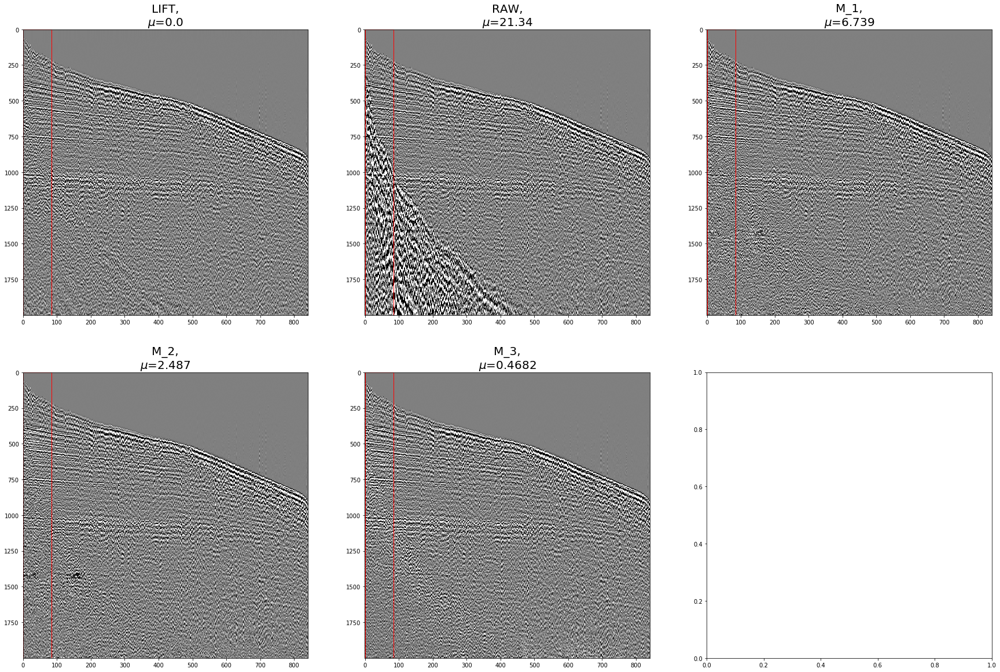

In [6]:
i=0
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

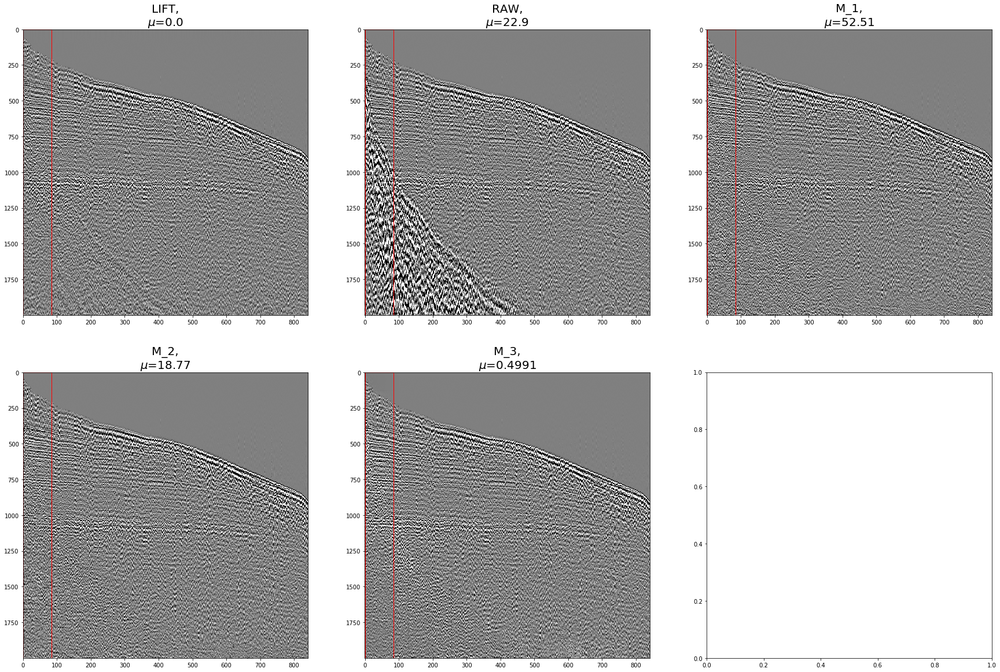

In [7]:
i=1
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

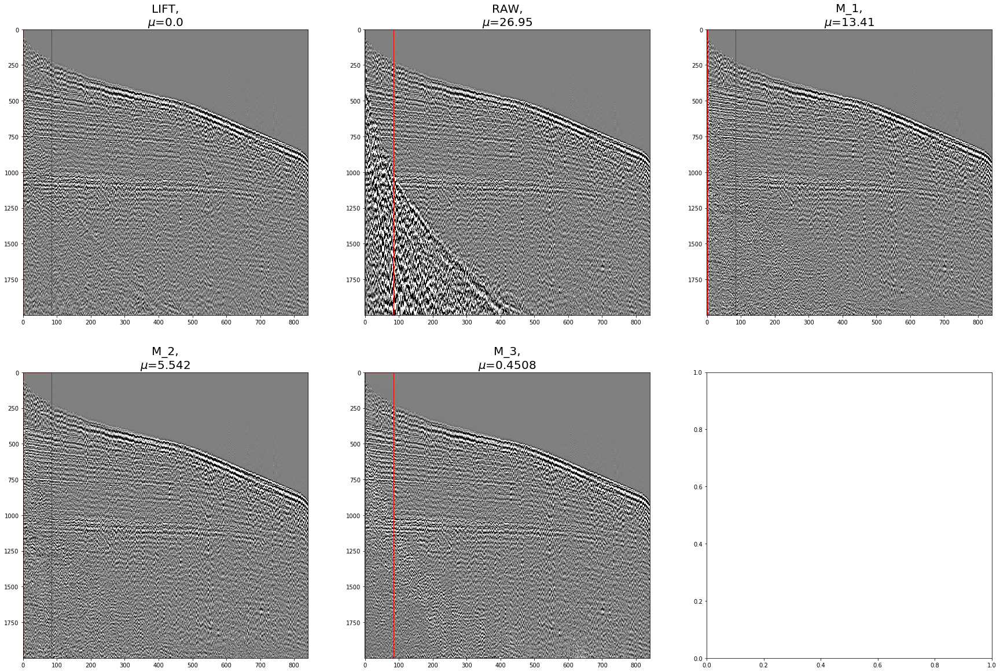

In [8]:
i=2
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

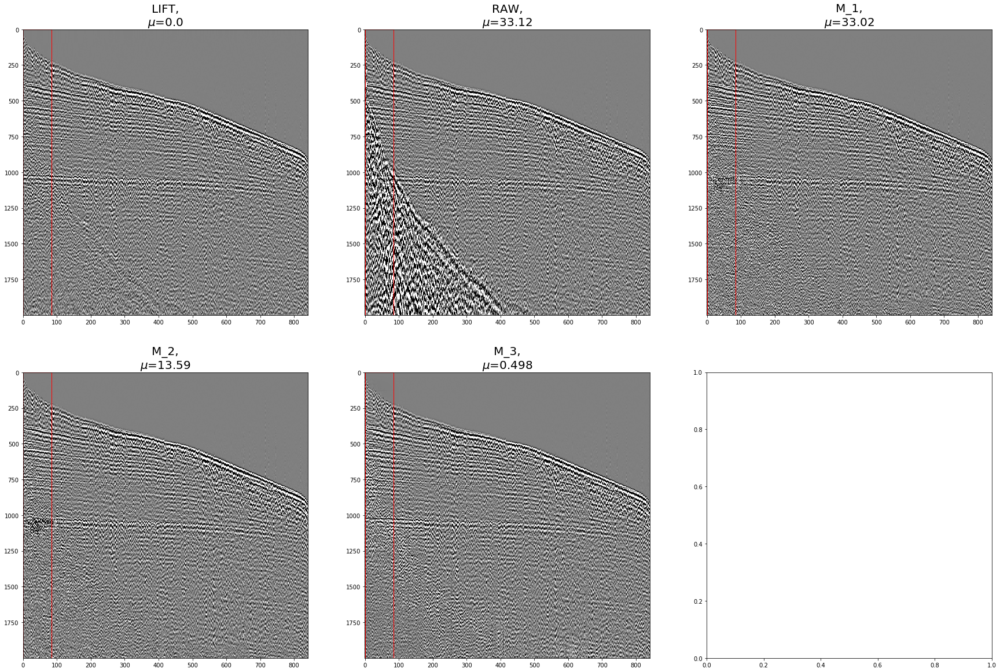

In [9]:
i=3
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

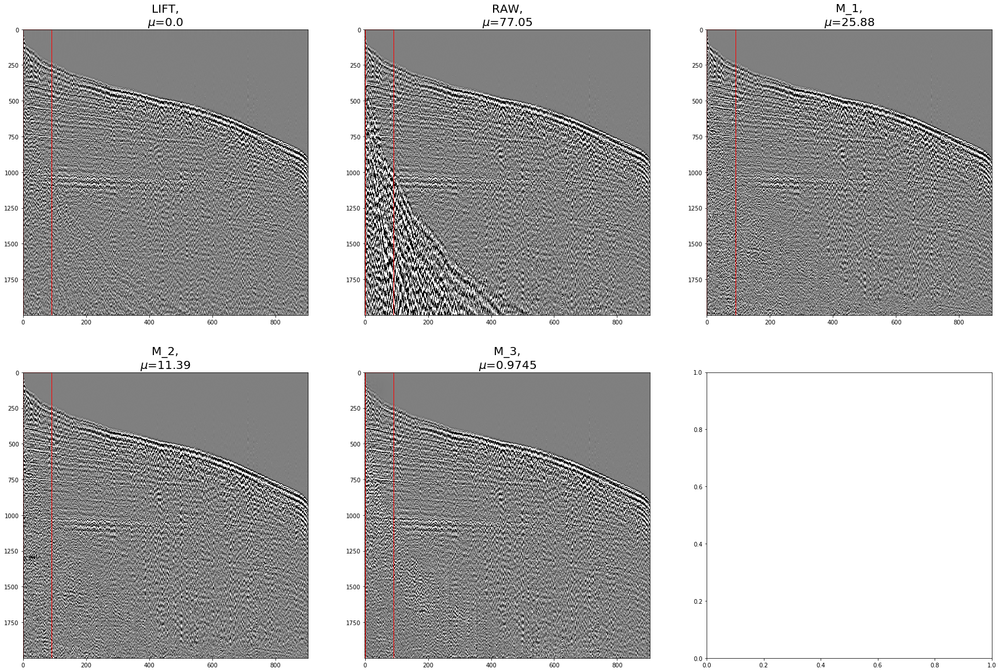

In [10]:
i=4
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

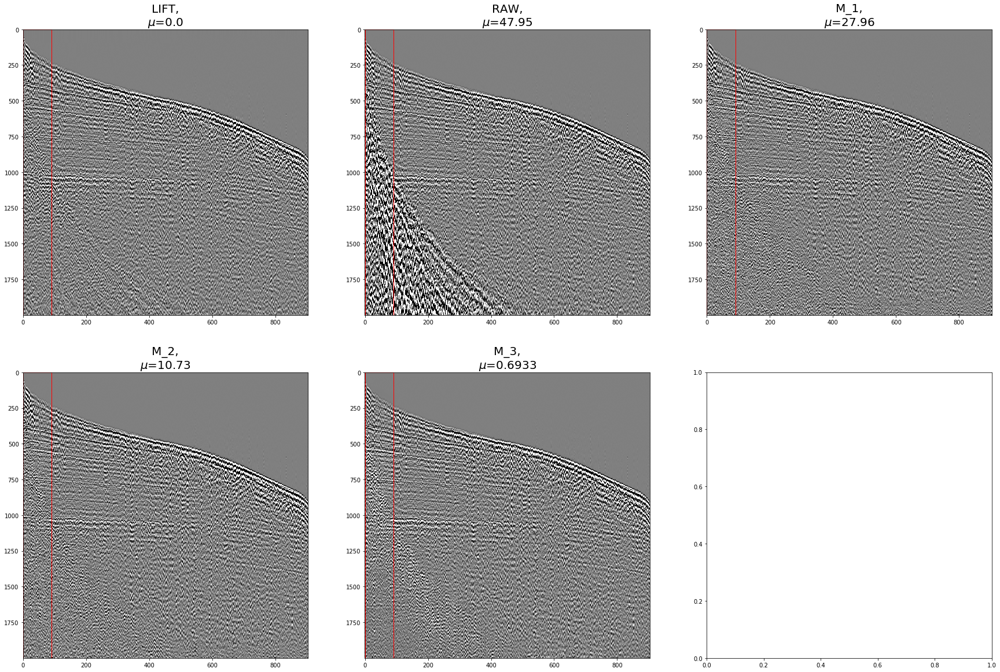

In [11]:
i=5
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

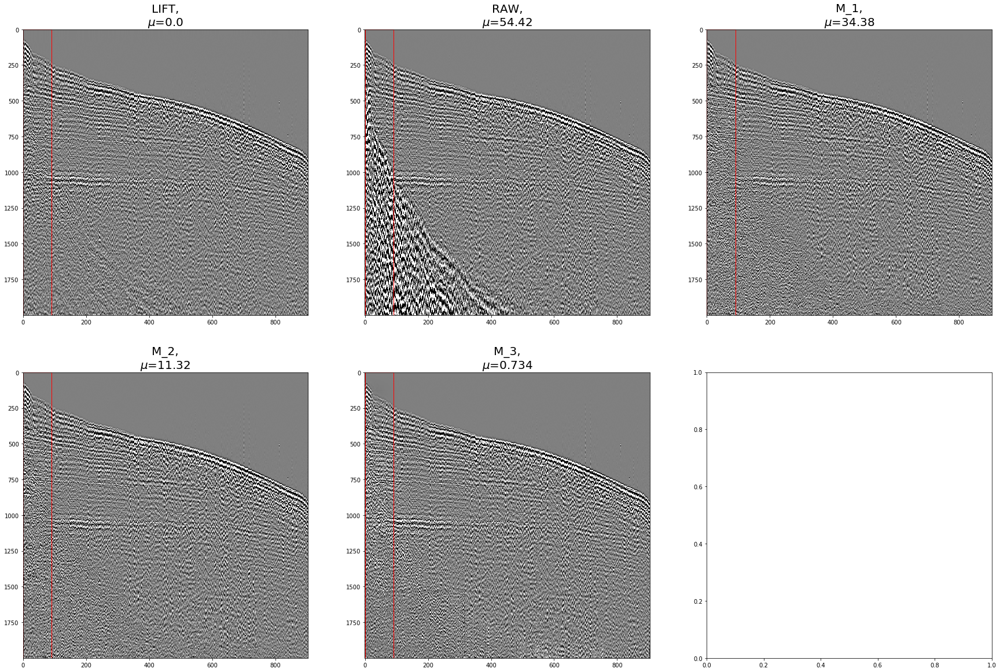

In [12]:
i=6
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

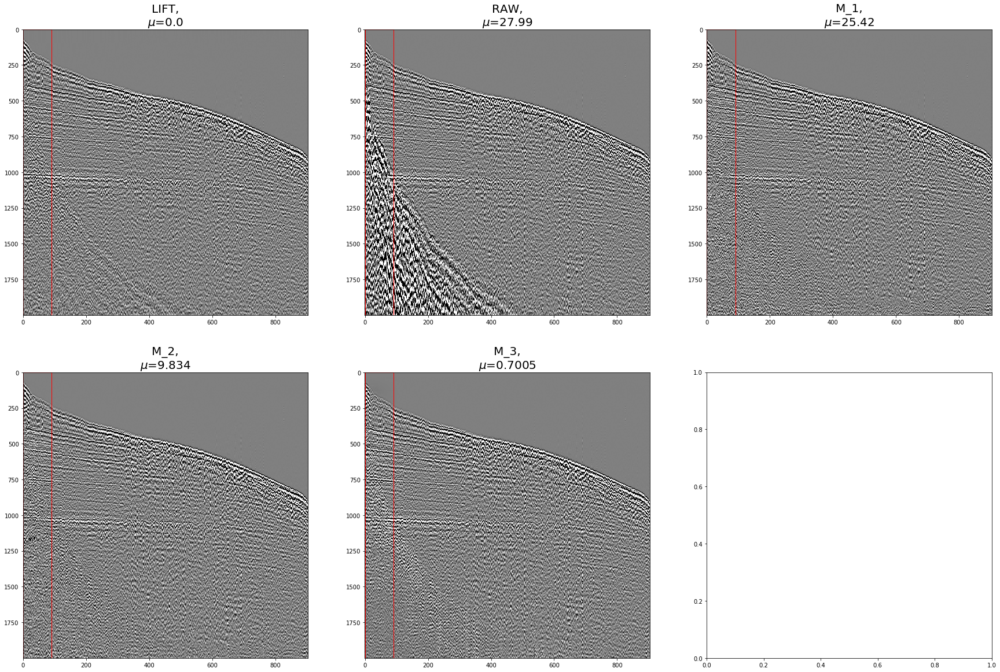

In [13]:
i=7
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

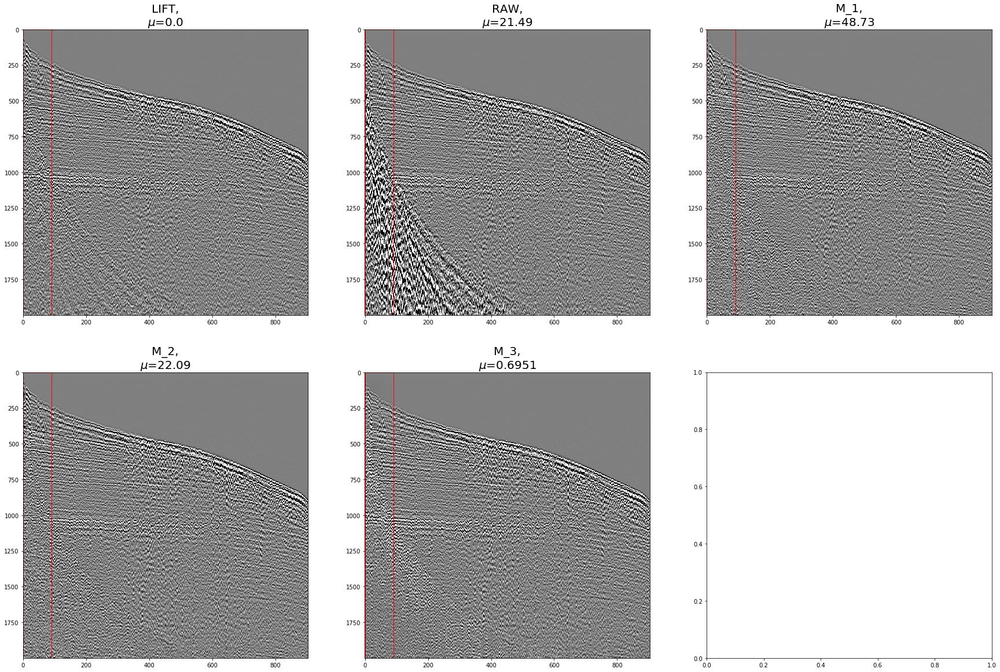

In [14]:
i=8
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')

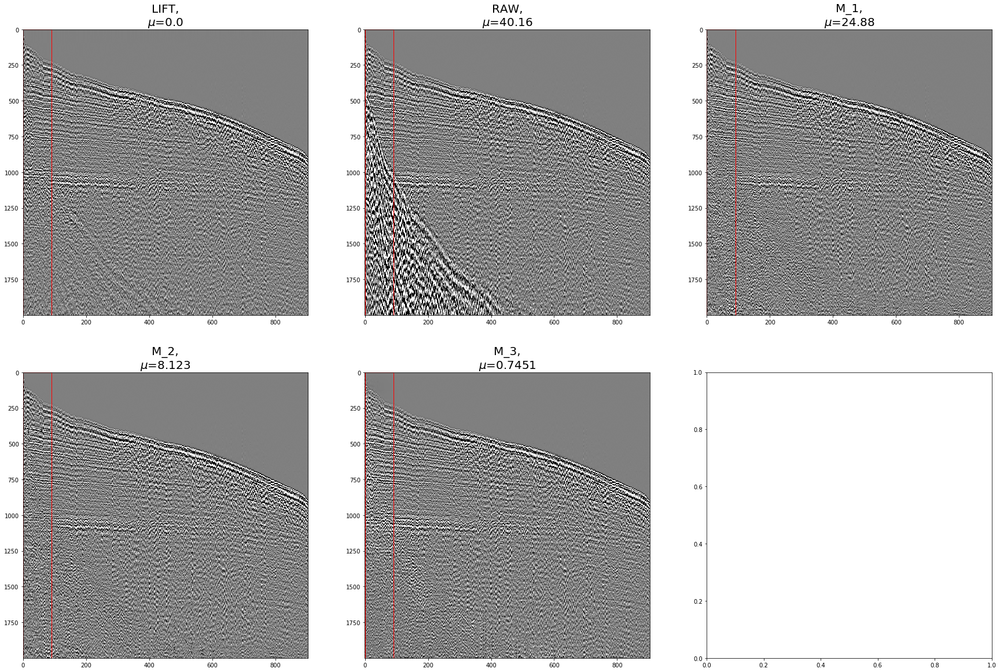

In [15]:
i=9
draw_modifications_dist(get_modifications_list(batch, i), vmin=-cv, vmax=cv,  figsize=(30, 20), n_cols=3, aspect='auto')